# Kaushal project setup

In [1]:
# Step 1: Install library (or show that it is installed)
!pip show mlend

Name: mlend
Version: 1.0.0.4
Summary: MLEnd Datasets
Home-page: https://MLEndDatasets.github.io
Author: Jesús Requena Carrión and Nikesh Bajaj
Author-email: nikkeshbajaj@gmail.com
License: MIT
Location: c:\programdata\anaconda3\envs\py310\lib\site-packages
Requires: joblib, matplotlib, numpy, pandas, scipy, spkit
Required-by: 


In [2]:
# Step 2: Import library and functions
import mlend
from mlend import download_deception_small, deception_small_load

In [3]:
# Step 3: Download small data
datadir = download_deception_small(save_to='MLEnd', subset={}, verbose=1, overwrite=False)

100%|▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓|100\100|00100.wav
Done!


In [4]:
# Step 4: Read file paths
TrainSet, TestSet, MAPs = deception_small_load(datadir_main=datadir, train_test_split=None, verbose=1, encode_labels=True)

Total 100 found in MLEnd\deception/MLEndDD_stories_small/


In [5]:
# Optional: Read documentation on the given functions
help(download_deception_small)
help(deception_small_load)

Help on function download_deception_small in module mlend.downloader:

download_deception_small(save_to='../MLEnd', subset={}, verbose=1, overwrite=False, pbar_style='colab')
    Download Deception Dataset - small size.
    
    
    Parameters
    ----------
    save_to: str, default ('../MLEnd')
       - local path where you want to store the data
         relative to `../MLEnd/deception/`).
    
    subset: dict, default={}
    -  subset of data to download. {'attribute_name':list_of_values to select}
        subset = {'Language':['English','Hindi']}, will download stories of English and Hindi langauge only 
        subset = {'Language':['English'], 'Story_type':['true_story']} will download true stories narrated in English only
        subset = {} will download entire small dataset (100 stories)
    
    subset of data
    
    verbose: bool, (default=1)
       - verbosity level, show progress
    
    overwrite: bool, default=False
       - to avoid downloaing files, if already ex

# Starter Kit Part 1: Understanding dataset

In [6]:
# Required libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os, sys, re, pickle, glob
import IPython.display as ipd
from tqdm import tqdm
import librosa

In [7]:
# Checking how many audio files we have
sample_path = 'MLEnd\deception\MLEndDD_stories_small\*.wav'
files = glob.glob(sample_path)
len(files)

<>:2: DeprecationWarning: invalid escape sequence '\d'


100

In [ ]:
# Let's listen to some random audio files:
for _ in range(5):
  n = np.random.randint(100)
  display(ipd.Audio(files[n]))

In [9]:
# Uploading the CSV file and loading it into Pandas
MLEND_df = pd.read_csv('MLEnd\deception\MLEndDD_story_attributes_small.csv').set_index('filename')
MLEND_df

,Language,Story_type
filename,,
00001.wav,Hindi,deceptive_story
00002.wav,English,true_story
00003.wav,English,deceptive_story
00004.wav,Bengali,deceptive_story
00005.wav,English,deceptive_story
...,...,...
00096.wav,English,deceptive_story
00097.wav,English,true_story
00098.wav,English,deceptive_story


In [10]:
# Checking the name of our audio files (to see if it matches "filename" in the dataframe)
for file in files:
  print(file.split('\\')[-1])

00001.wav
00002.wav
00003.wav
00004.wav
00005.wav
00006.wav
00007.wav
00008.wav
00009.wav
00010.wav
00011.wav
00012.wav
00013.wav
00014.wav
00015.wav
00016.wav
00017.wav
00018.wav
00019.wav
00020.wav
00021.wav
00022.wav
00023.wav
00024.wav
00025.wav
00026.wav
00027.wav
00028.wav
00029.wav
00030.wav
00031.wav
00032.wav
00033.wav
00034.wav
00035.wav
00036.wav
00037.wav
00038.wav
00039.wav
00040.wav
00041.wav
00042.wav
00043.wav
00044.wav
00045.wav
00046.wav
00047.wav
00048.wav
00049.wav
00050.wav
00051.wav
00052.wav
00053.wav
00054.wav
00055.wav
00056.wav
00057.wav
00058.wav
00059.wav
00060.wav
00061.wav
00062.wav
00063.wav
00064.wav
00065.wav
00066.wav
00067.wav
00068.wav
00069.wav
00070.wav
00071.wav
00072.wav
00073.wav
00074.wav
00075.wav
00076.wav
00077.wav
00078.wav
00079.wav
00080.wav
00081.wav
00082.wav
00083.wav
00084.wav
00085.wav
00086.wav
00087.wav
00088.wav
00089.wav
00090.wav
00091.wav
00092.wav
00093.wav
00094.wav
00095.wav
00096.wav
00097.wav
00098.wav
00099.wav
00100.wav


# Starter Kit Part 2: Feature extraction : Pitch

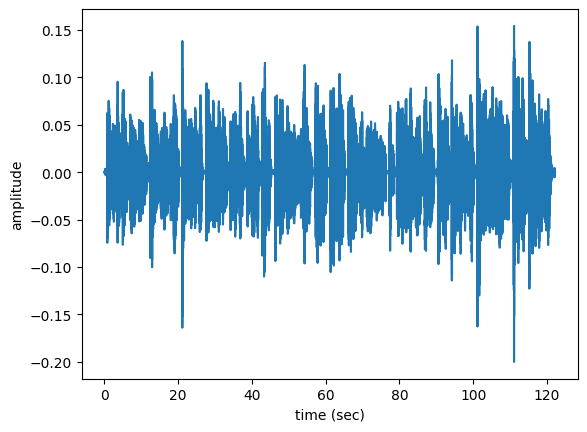

In [11]:
# Plotting one of our audio files
n=0
fs = None # Sampling frequency
x, fs = librosa.load(files[n],sr=fs)
t = np.arange(len(x))/fs
plt.plot(t,x)
plt.xlabel('time (sec)')
plt.ylabel('amplitude')
plt.show()
display(ipd.Audio(files[n]))

In [12]:
# Using the filename, we can extract its label from the MLEnd_df DataFrame
MLEND_df.loc[files[n].split('\\')[-1]]

Language                Hindi
Story_type    deceptive_story
Name: 00001.wav, dtype: object

In [13]:
# Printing the number of audio samples
n=0
x, fs = librosa.load(files[n],sr=fs)
print('This audio signal has', len(x), 'audio samples')

This audio signal has 5387576 audio samples


In [14]:
# Function that gets the pitch of an audio signal
def getPitch(x,fs,winLen=0.02):
  #winLen = 0.02
  p = winLen*fs
  frame_length = int(2**int(p-1).bit_length())
  hop_length = frame_length//2
  f0, voiced_flag, voiced_probs = librosa.pyin(y=x, fmin=80, fmax=450, sr=fs,
                                                 frame_length=frame_length,hop_length=hop_length)
  return f0,voiced_flag

In [15]:
# Function that takes audio files and creates predictors and label
def getXy(files,labels_file, scale_audio=False, onlySingleDigit=False):
  X,y =[],[]
  for file in tqdm(files):
    fileID = file.split('\\')[-1]
    file_name = file.split('\\')[-1]
    yi = labels_file.loc[fileID]['Story_type']=='true_story'

    fs = None # if None, fs would be 22050
    x, fs = librosa.load(file,sr=fs)
    if scale_audio: x = x/np.max(np.abs(x))
    f0, voiced_flag = getPitch(x,fs,winLen=0.02)

    power = np.sum(x**2)/len(x)
    pitch_mean = np.nanmean(f0) if np.mean(np.isnan(f0))<1 else 0
    pitch_std  = np.nanstd(f0) if np.mean(np.isnan(f0))<1 else 0
    voiced_fr = np.mean(voiced_flag)

    xi = [power,pitch_mean,pitch_std,voiced_fr]
    X.append(xi)
    y.append(yi)

  return np.array(X),np.array(y)

In [16]:
# Applying above function on our dataset
X,y = getXy(files, labels_file=MLEND_df, scale_audio=True, onlySingleDigit=True)

100%|██████████| 100/100 [45:17<00:00, 27.18s/it]


In [17]:
# Printing the shape of X and y
print('The shape of X is', X.shape)
print('The shape of y is', y.shape)

# Printing the labels vector y
print('The labels vector is', y)

The shape of X is (100, 4)
The shape of y is (100,)
The labels vector is [False  True False False False False  True False False  True False  True
 False  True False  True  True  True False  True  True False False  True
  True  True False  True  True  True False False False  True  True False
 False False False False False  True  True False False False  True  True
 False False False  True False  True  True False  True False  True False
  True  True  True  True False  True False  True False False False False
  True  True  True  True False  True  True  True False  True  True  True
  True False  True  True False False  True  True False False False False
  True False  True False]


In [18]:
# Checking if our dataset is balanced (equal number of true and false stories?)
print(' The number of true stories is ', np.count_nonzero(y))
print(' The number of deceptive stories is ', y.size - np.count_nonzero(y))

 The number of true stories is  50
 The number of deceptive stories is  50


# Starter Kit Part 3: Modelling (Support Vector Machines)

In [19]:
# Importing SVM and splitting the dataset
from sklearn import svm
from sklearn.model_selection import train_test_split

X_train, X_val, y_train, y_val = train_test_split(X,y,test_size=0.3)
X_train.shape, X_val.shape, y_train.shape, y_val.shape

((70, 4), (30, 4), (70,), (30,))

In [20]:
# Fitting an SVM model and printing training and validation accuracy
model  = svm.SVC(C=1)
model.fit(X_train,y_train)

yt_p = model.predict(X_train)
yv_p = model.predict(X_val)

print('Training Accuracy', np.mean(yt_p==y_train))
print('Validation  Accuracy', np.mean(yv_p==y_val))
print('The support vectors are', model.support_vectors_.shape)

Training Accuracy 0.5142857142857142
Validation  Accuracy 0.4666666666666667
The support vectors are (69, 4)


In [21]:
# Normalising the predictors to see if performance improves
mean = X_train.mean(0)
sd =  X_train.std(0)

X_train = (X_train-mean)/sd
X_val  = (X_val-mean)/sd

model  = svm.SVC(C=1,gamma=2)
model.fit(X_train,y_train)

yt_p = model.predict(X_train)
yv_p = model.predict(X_val)

print('Training Accuracy', np.mean(yt_p==y_train))
print('Validation  Accuracy', np.mean(yv_p==y_val))
print('The support vectors are', model.support_vectors_.shape)

Training Accuracy 0.9
Validation  Accuracy 0.4
The support vectors are (69, 4)
